In [1]:
%pylab inline
import os
import gc
import scipy
import numpy as np
import catutil as utilities
import imgSimutil as imgUtil
import astropy.io.fits as pyfits
from astropy.table import Table,vstack,hstack

Populating the interactive namespace from numpy and matplotlib


In [2]:
cd wrkDir/FPFS2/sim2/

/lustre/work/xiangchong.li/work/FPFS2/sim2


In [99]:
#pList=['45','60','75']
#pList=['60','75','90']
ver='CosmoR'
pltDir='./plot/histograms%s/' %ver
if not os.path.isdir(pltDir):
    os.mkdir(pltDir)
pList=['60','105','HSC']
ddAll=[]
for psz in pList:
    datAll=[]
    for index in range(4,5):
        pixId= imgUtil.cosmoHSThpix[index]
        for ii in range(4):
            inoi= ii#index*(30)+ii
            data= Table.read('out%s-var36em4/src-psf%s-%d/src%04d-g1-0000.fits' %(ver,psz,pixId,inoi))
            datAll.append(data)
            del data
            gc.collect()
    datAll=vstack(datAll)
    datAll['a_i']=0.
    msk=utilities.get_wl_flags(datAll)
    datAll=datAll[msk]
    ddAll.append(datAll)
    del datAll
    gc.collect()

/lustre/work/xiangchong.li/superonionIDark/code/FPFS_Private/FPFSBASE/python/catutil.py:1056: RuntimeWarning: invalid value encountered in log10
  magnitude   =   -2.5 * np.log10(catalog['modelfit_CModel_instFlux']) + 27.
/lustre/work/xiangchong.li/superonionIDark/code/FPFS_Private/FPFSBASE/python/catutil.py:975: RuntimeWarning: invalid value encountered in log10
  magnitude   =   -2.5 * np.log10(catalog['base_CircularApertureFlux_3_0_instFlux']) + 27.


In [79]:
datDir=os.path.join(os.environ['homeWrk'],'galSim-HSC/s19/s19-1/anaCat_newS19Mask_fdeltacut/catalog_obs_reGaus_no_m')
datname=os.path.join(datDir,'GAMA09H_no_m.fits')
dataHSC=pyfits.getdata(datname)
if True:
    pixId=imgUtil.cosmoHSThpix[4]
    cosmo252 =  imgUtil.cosmoHSTGal('252')
    info    =   cosmo252.hpInfo[cosmo252.hpInfo['pix']==pixId]
    msk=(dataHSC['i_ra']>info['raMin'])&((dataHSC['i_ra']<info['raMax']))\
        &(dataHSC['i_dec']>info['decMin'])&((dataHSC['i_dec']<info['decMax']))
    dataHSC=dataHSC[msk]

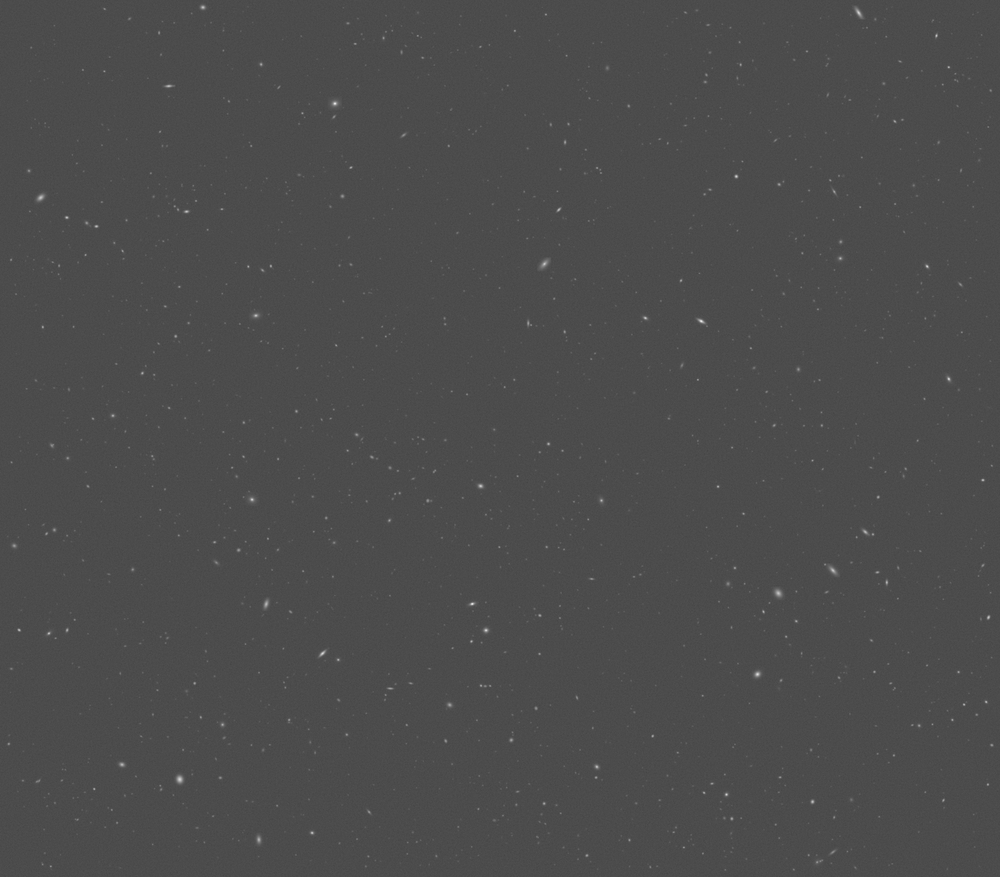

In [29]:
from IPython.display import Image
pltDir='./plot/simDemo/'
Image(os.path.join(pltDir,"cosmoSimDemo.png"))

117.60366907336687
9061
124.09432211716995
4161
115.39679415270874
10631


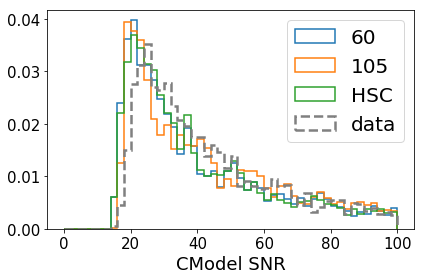

In [100]:
for i in range(len(pList)):
    snr=utilities.get_snr(ddAll[i])
    a=plt.hist(snr,bins=50,range=(0.,100),density=True,histtype='step',\
            linewidth=1.5,ls='-',label=pList[i])
    print(np.average(snr))
    print(len(ddAll[i]))
    del snr
    gc.collect()
snr=utilities.get_snr(dataHSC)
a=plt.hist(snr,bins=50,range=(0.,100),density=True,histtype='step',\
        linewidth=2.5,ls='--',color='grey',label='data')
del snr,a
gc.collect()
plt.xlabel('CModel SNR')
plt.legend()
plt.tight_layout()
plt.savefig(os.path.join(pltDir,'snrDis.png'))

0.5385797438361289
0.46605024090526026
0.5755004513416204


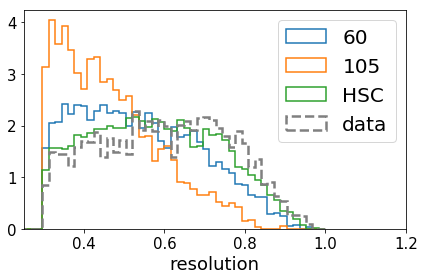

In [101]:
for i in range(len(pList)):
    res=utilities.get_res(ddAll[i])
    plt.hist(res,bins=50,range=(0.2,1.),density=True,histtype='step',\
            linewidth=1.5,ls='-',label=pList[i])
    print(np.average(res))
    del res
    gc.collect
res=utilities.get_res(dataHSC)
a=plt.hist(res,bins=50,range=(0.2,1.),density=True,histtype='step',\
        linewidth=2.5,ls='--',color='grey',label='data')
plt.xlabel('resolution')
plt.legend()
plt.xlim(0.25,1.2)
plt.tight_layout()
plt.savefig(os.path.join(pltDir,'resDis.png'))

23.089043630346477
22.519279188840766
23.138846068813223


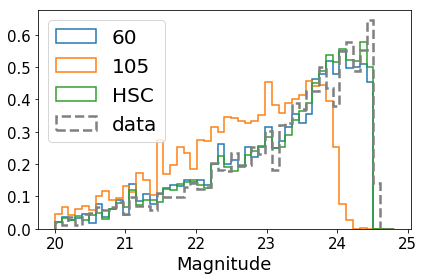

In [102]:
for i in range(len(pList)):
    mag=utilities.get_imag(ddAll[i])
    a=plt.hist(mag,bins=50,range=(20,24.8),density=True,histtype='step',\
            linewidth=1.5,ls='-',label=pList[i])
    print(np.average(mag))
    del mag
    gc.collect()
mag=utilities.get_imag(dataHSC)
a=plt.hist(mag,bins=50,range=(20,24.8),density=True,histtype='step',\
        linewidth=2.5,ls='--',color='grey',label='data')
del mag,a
gc.collect()
plt.xlabel('Magnitude')
plt.legend(loc='upper left')
plt.tight_layout()
plt.savefig(os.path.join(pltDir,'magDis.png'))

0.6040059715769553
0.6311886987956341
0.5552442014396437


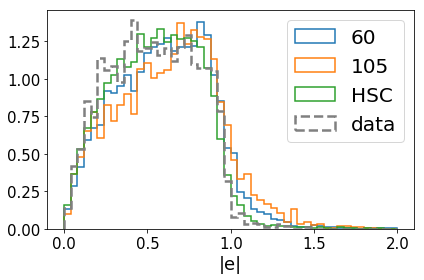

In [103]:
for i in range(len(pList)):
    absE=utilities.get_abs_ellip(ddAll[i])
    a=plt.hist(absE,bins=50,range=(0,2.),density=True,histtype='step',\
            linewidth=1.5,ls='-',label=pList[i])
    print(np.average(absE))
    del absE,a
    gc.collect()
absE=utilities.get_abs_ellip(dataHSC)
a=plt.hist(absE,bins=50,range=(0,2),density=True,histtype='step',\
        linewidth=2.5,ls='--',color='grey',label='data')
del absE,a
gc.collect()
plt.xlabel('|e|')
plt.legend()
plt.tight_layout()
plt.savefig(os.path.join(pltDir,'absEDis.png'))

24.063587452764637
24.202453335797525
24.06719114030363


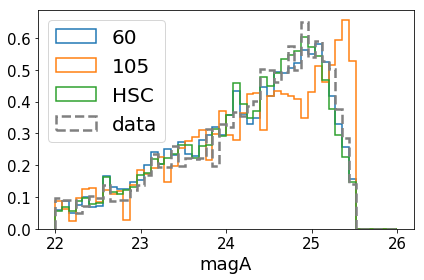

In [105]:
for i in range(len(pList)):
    magA10=utilities.get_imag_A10(ddAll[i])
    a=plt.hist(magA10,bins=50,range=(22,26),density=True,histtype='step',\
            linewidth=1.5,ls='-',label=pList[i])
    print(np.average(magA10))
magA10=utilities.get_imag_A10(dataHSC)
a=plt.hist(magA10,bins=50,range=(22,26),density=True,histtype='step',\
        linewidth=2.5,ls='--',color='grey',label='data')
del magA10
gc.collect()
plt.xlabel('magA')
plt.legend(loc='upper left')
plt.tight_layout()
plt.savefig(os.path.join(pltDir,'magADis.png'))

$$
\left(\begin{array}{cc} 
\hat{e}_1^{a}\\ 
\hat{e}_1^{b}
\end{array}\right)
=
\left(\begin{array}{cc} 
R_{aa} & R_{ab}\\
R_{ba} & R_{bb}
\end{array}\right)
\left(\begin{array}{cc}
\gamma_1^{a}\\ 
\gamma_1^{b}
\end{array}\right)+ 
\left(\begin{array}{cc}
\bar{e}_1^{a}\\ 
\bar{e}_1^{b}
\end{array}\right)
$$

$
\left(\begin{array}{cc}
\gamma\\ 
0
\end{array}\right),
\left(\begin{array}{cc}
0\\ 
\gamma
\end{array}\right),
\left(\begin{array}{cc}
0\\ 
0
\end{array}\right)
$

$
\left(\begin{array}{cc}
\gamma\\ 
\gamma
\end{array}\right),
\left(\begin{array}{cc}
0\\ 
0
\end{array}\right)
$

## Simulation Setup:

+ Use parametric galaxy models fitted to cosmos galaxies (then we can distort differently galaxy with different shear)
+ Input the galaxies to the cosmos positions (diferent from DES --- random positions)
+ Distort galaxies with z-dependent shear (-0.02,-0.02,-0.02,-0.02) , (0.02,-0.02,-0.02,-0.02), (-0.02,0.02,-0.02,-0.02)
+ The boundary of redshift bins are: [0.,0.561,0.906,1.374,5.410]
+ Only i-band
+ Use the average PSF seeing --- 0.6,0.8 arcsec (Moffat PSF) and 0.57 arcsec (HSC PSF)
+ Use the average noise variance --- 3.6e-3
+ Use an averge noise correlation function

## TODO:

+ Study how the redshift-dependent shear changes the n(z)

## Question:

+ Do we need to make the simulation more realistic? (HSC PSF, multiple noise variance?)

4324
5210


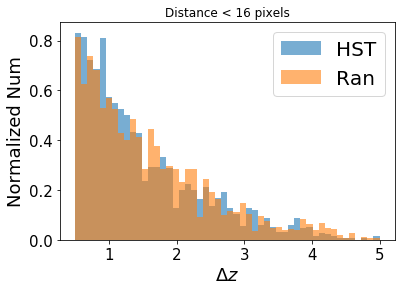

In [81]:
norm=True
disThres=16
plt.close()
hstcat =    pyfits.getdata('hstcatE.fits')
xyRef   =   np.vstack([hstcat['xI'],hstcat['yI']]).T
tree    =   scipy.spatial.cKDTree(xyRef)
dis,inds=tree.query(xyRef,k=2)
msk=dis[:,1]<disThres
print(np.sum(msk))
absDz=np.abs(hstcat[inds[:,1][msk]]['zphot']-hstcat[msk]['zphot'])
hist1,bin1,_=plt.hist(absDz,alpha=0.6,label='HST',bins=50,range=(0.5,5),normed=norm)

hstcat =    pyfits.getdata('hstcatR.fits')
xyRef   =   np.vstack([hstcat['xI'],hstcat['yI']]).T
tree    =   scipy.spatial.cKDTree(xyRef)
dis,inds=tree.query(xyRef,k=2)
msk=dis[:,1]<disThres
print(np.sum(msk))
absDz=np.abs(hstcat[inds[:,1][msk]]['zphot']-hstcat[msk]['zphot'])
hist2,bin2,_2=plt.hist(absDz,alpha=0.6,label='Ran',bins=50,range=(0.5,5),normed=norm)
plt.xlabel(r'$\Delta z$')
plt.ylabel('Normalized Num')
plt.title('Distance < 16 pixels')
plt.legend()